# Unzipping the Files

In [1]:
# !unzip /content/drive/MyDrive/intern-assignment-20210728T071939Z-001.zip

# Import Required Libraries

In [2]:
import xml.etree.cElementTree as etree
import pandas as pd
import cv2
from google.colab.patches import cv2_imshow

# Defining the Necessary Function

In [3]:
def extract_info(xml_path,tags):
    temp = []
    for _, el in etree.iterparse(xml_path):
        if el.text and not el: # leaf element with text
            if el.tag in tags:
                temp.append(el.text)
    return temp

In [4]:
def chunks(lst, n):
    """Yield successive n-sized chunks from lst."""
    for i in range(0, len(lst), n):
        yield lst[i:i + n]

In [5]:
def preprocess_data(xml_path):
    tags = ['name','xmin','ymin','xmax','ymax']
    path = xml_path
    temp = extract_info(path,tags)
    values = list(chunks(temp, 5))
    df = pd.DataFrame(data=values, columns = tags)
    return df

In [6]:
def min_max_values(df,start_point_shift=1, end_point_shift=1):
    xmin = []
    ymin = []
    xmax = []
    ymax = []
    text = []
    for i in range(len(df)):
        xmin.append(int(float(df['xmin'][i]))+start_point_shift)    
        ymin.append(int(float(df['ymin'][i]))+start_point_shift)    
        xmax.append(int(float(df['xmax'][i]))+end_point_shift)    
        ymax.append(int(float(df['ymax'][i]))+end_point_shift) 
        text.append(df['name'][i]) 
    return xmin , ymin , xmax , ymax , text

In [7]:
def plot_image(xml_path,img_path,font=cv2.FONT_HERSHEY_COMPLEX,fontscale=0.5,start_point_shift=1, end_point_shift=1):
    df = preprocess_data(xml_path)
    xmin, ymin, xmax,ymax ,text = min_max_values(df,start_point_shift, end_point_shift)
    img = cv2.imread(img_path)
    for i in range(len(df)):
        start_point = (xmin[i], ymin[i])
        end_point = (xmax[i],ymax[i])
        image = cv2.rectangle(img, start_point,end_point, (0,255,0), 1)

        #text
        text_on_image = text[i]
        origin = (xmin[i], ymin[i]-10)
        # font = cv2.FONT_HERSHEY_COMPLEX

        image_text = cv2.putText(image, text_on_image, origin, font, fontscale, (0,255,0))
        cv2.imwrite(img_path.split('/')[-1],image)
    return cv2_imshow(image)

# OUTPUTS


## 1. Image

In [10]:
import glob
xml_list = []
image_list = []
for file in glob.glob("/content/drive/MyDrive/YOLO_V4/frames/*.jpg"):
    image_list.append(file)
for file in glob.glob("/content/drive/MyDrive/YOLO_V4/frames/*.JPG"):
    image_list.append(file)
for file in glob.glob("/content/drive/MyDrive/YOLO_V4/xml files/*.xml"):
    xml_list.append(file)

In [38]:
img_and_xml = []
for i in image_list:
    for j in xml_list:
        just = i.split('/')[-1].split('.')[0]
        if just == j.split('/')[-1].split('.')[0]:
            img_and_xml.append((i,j))

In [42]:
img_and_xml

[('/content/drive/MyDrive/YOLO_V4/frames/car_backlight_red.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/car_backlight_red.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/uda_1_g_0118.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/uda_1_g_0118.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/15.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/15.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/uda_y_0064.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/uda_y_0064.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/IMG_0000.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/IMG_0000.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/sim_g_0079.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/sim_g_0079.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/uda_1_y_0091.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/uda_1_y_0091.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/2.jpg',
  '/content/drive/MyDrive/YOLO_V4/xml files/2.xml'),
 ('/content/drive/MyDrive/YOLO_V4/frames/8.jpg',
  '/con

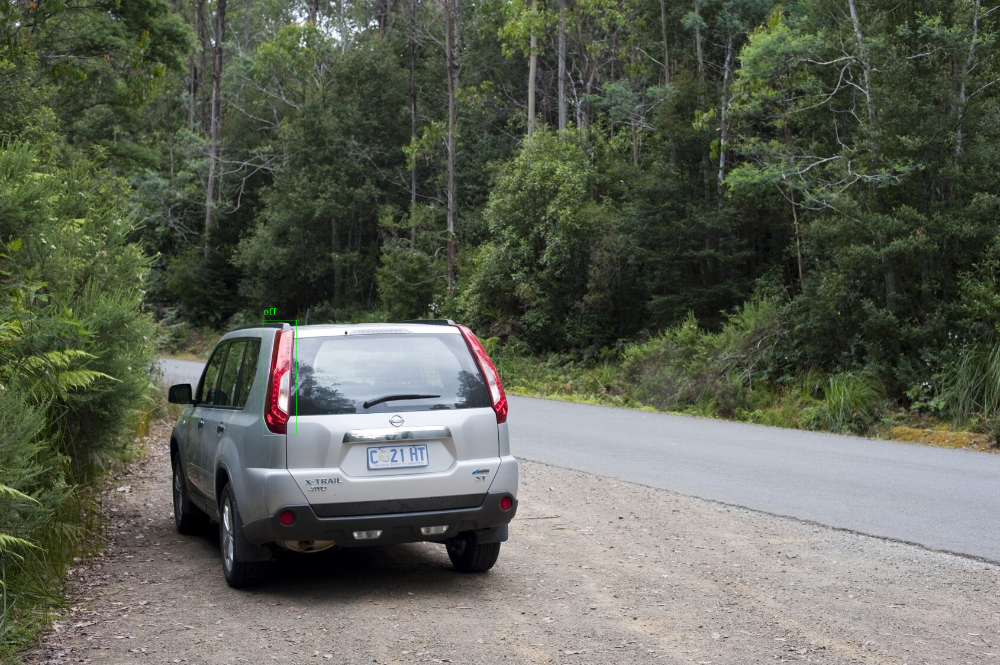

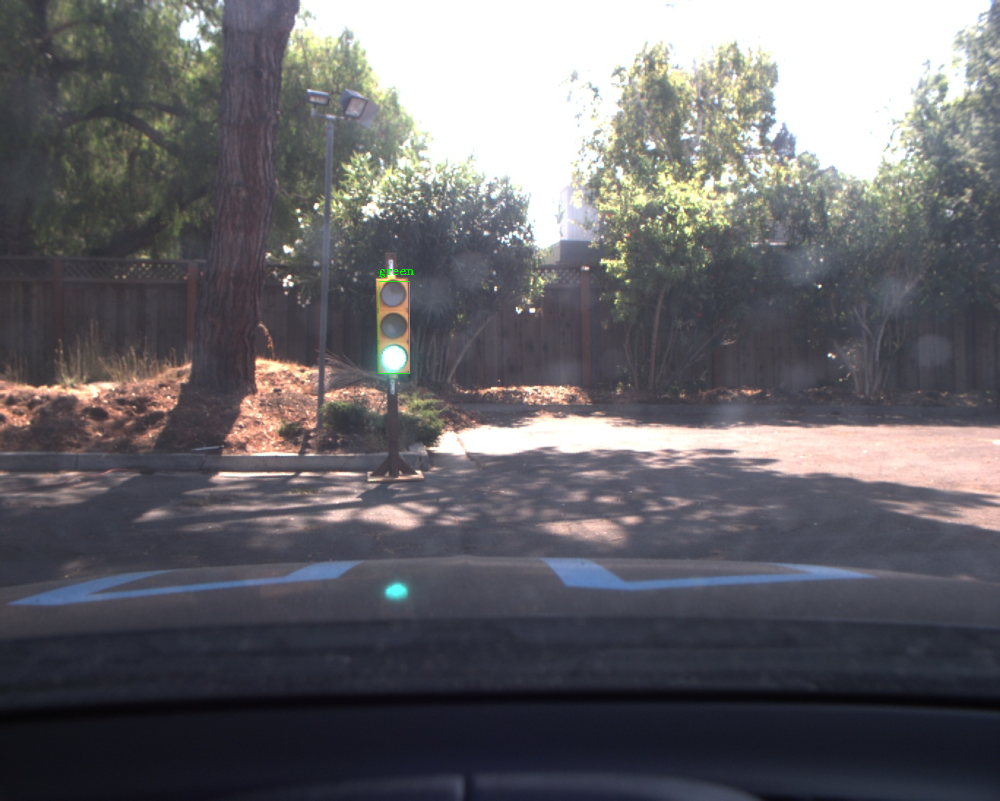

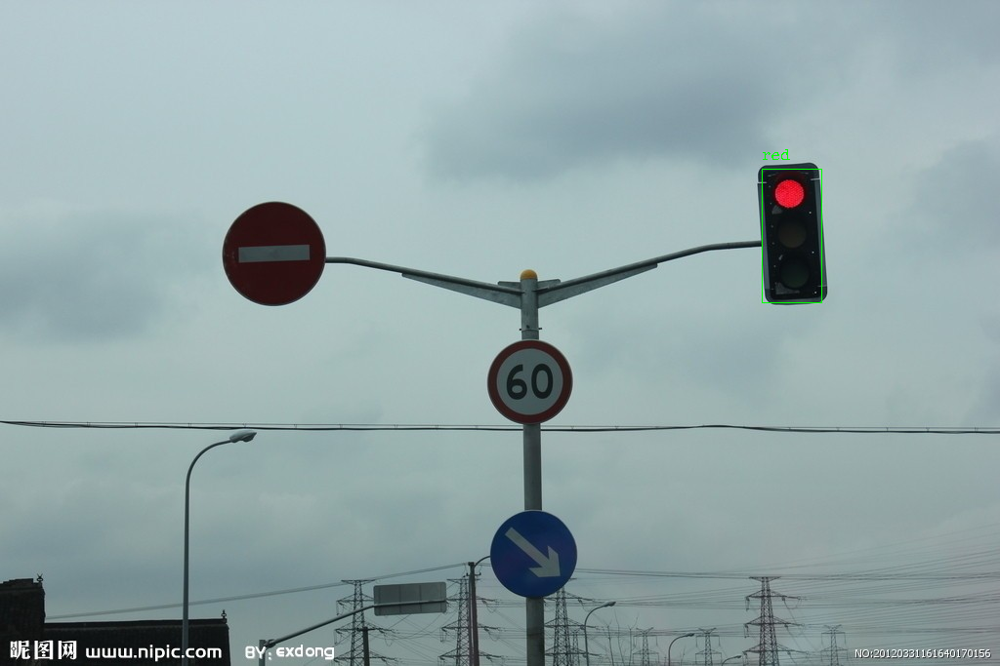

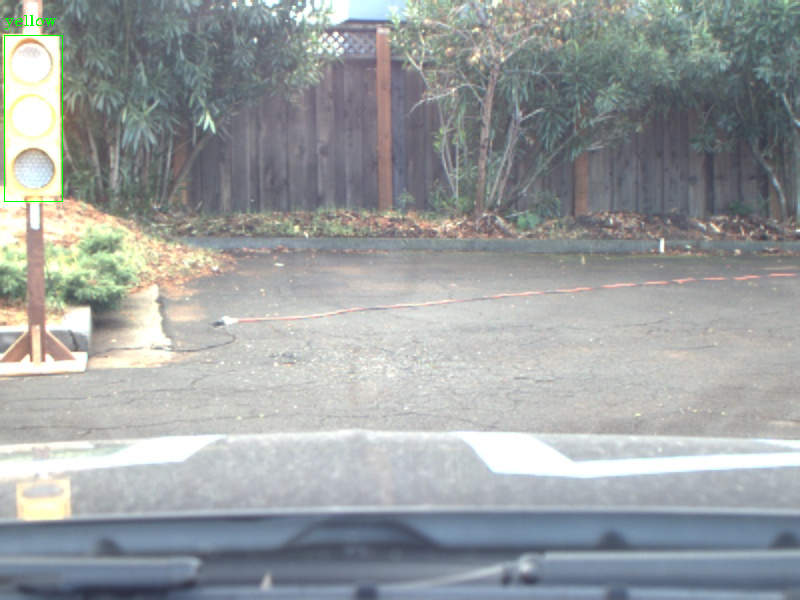

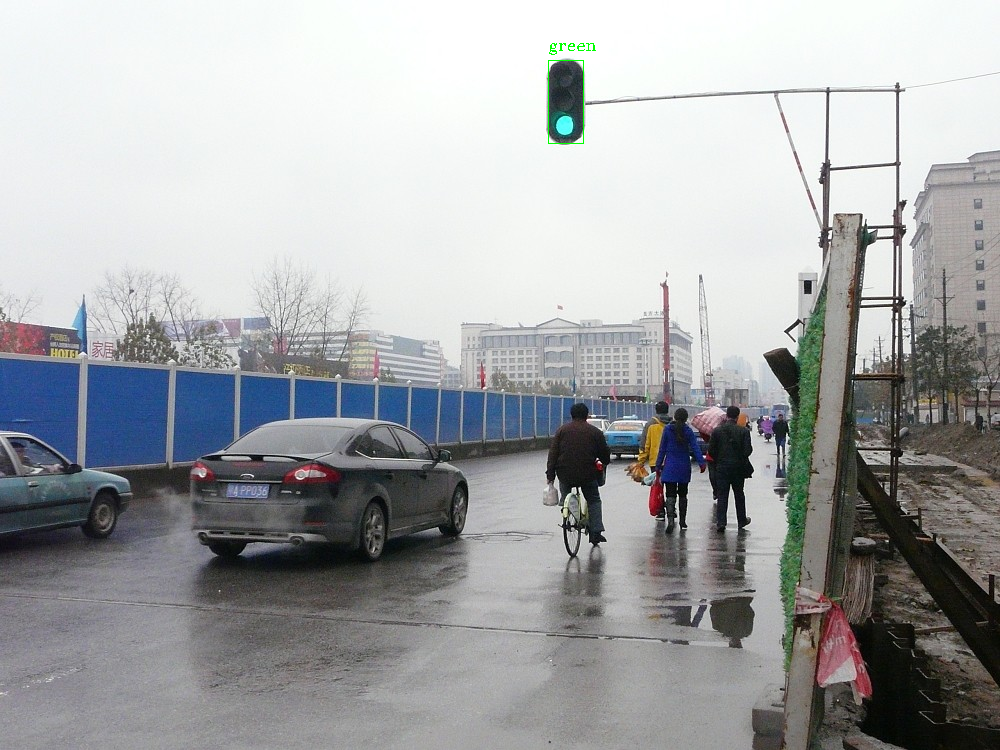

...

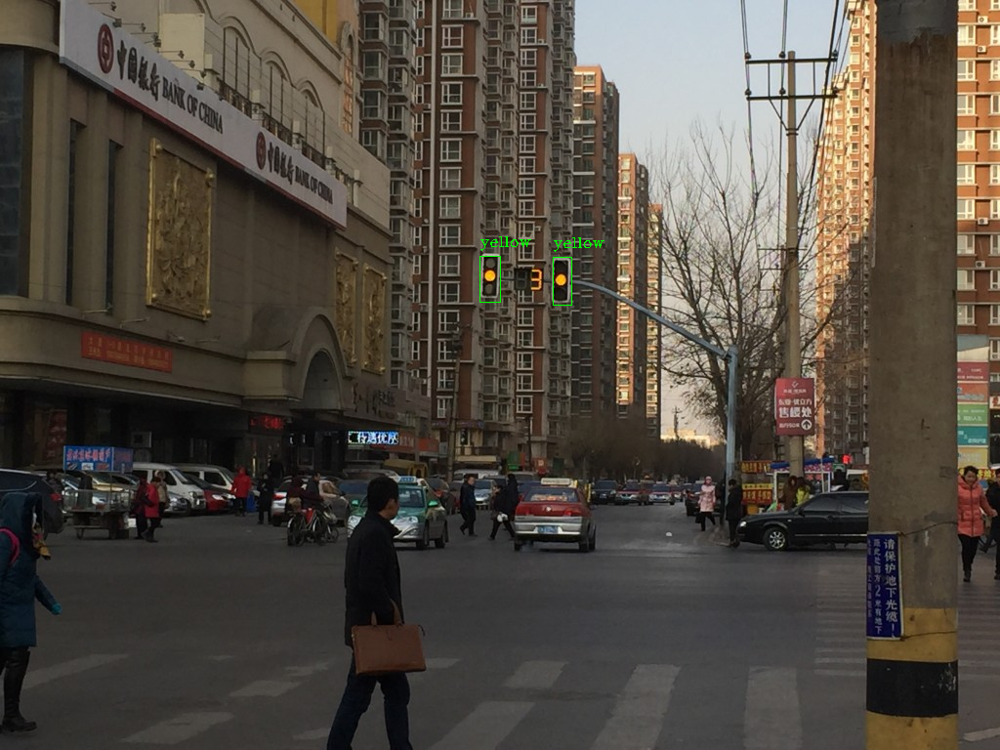

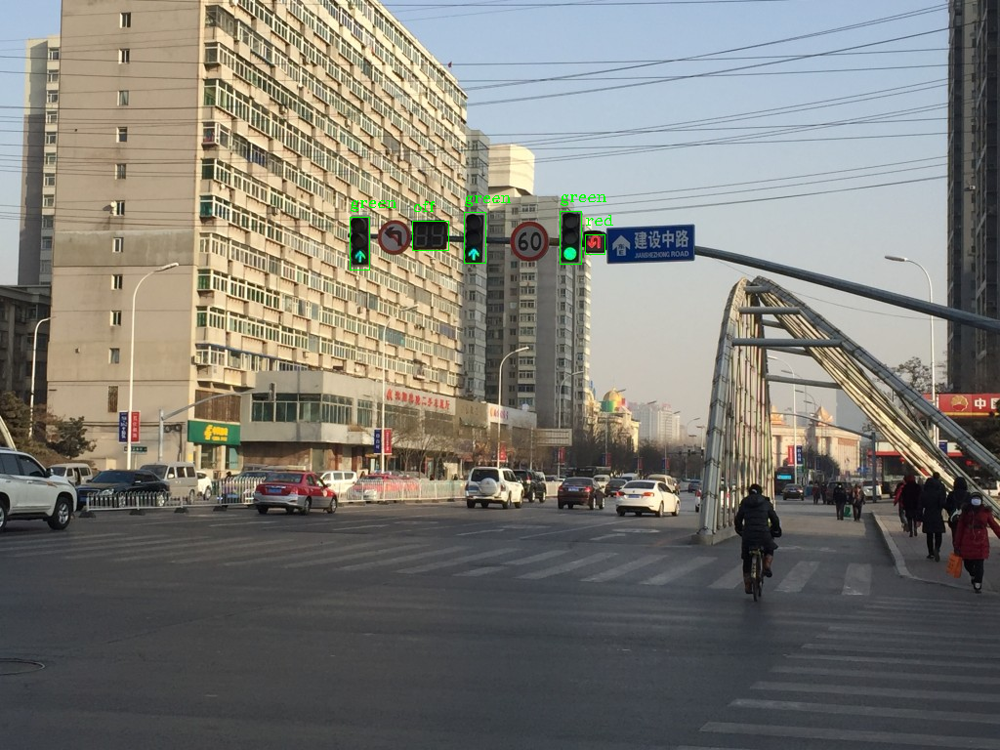

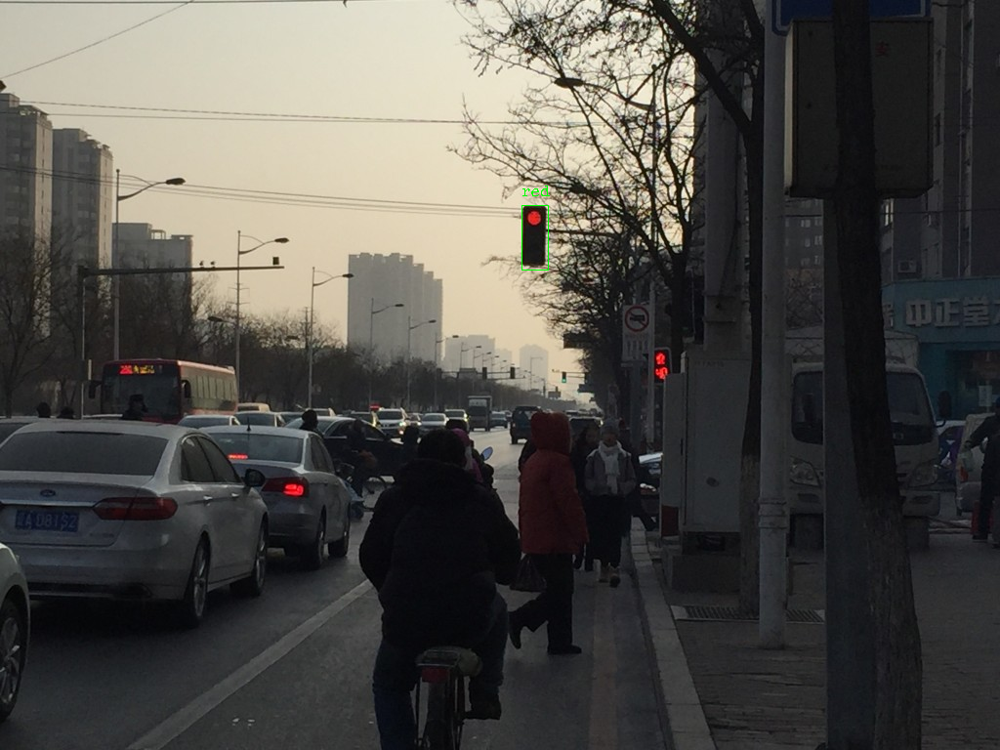

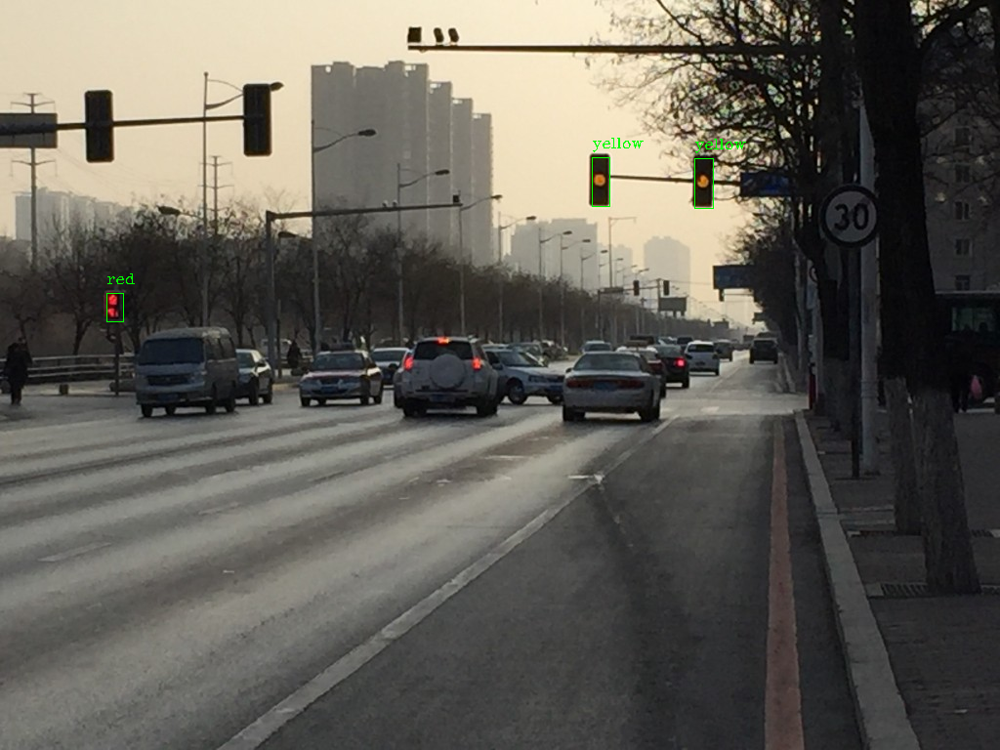

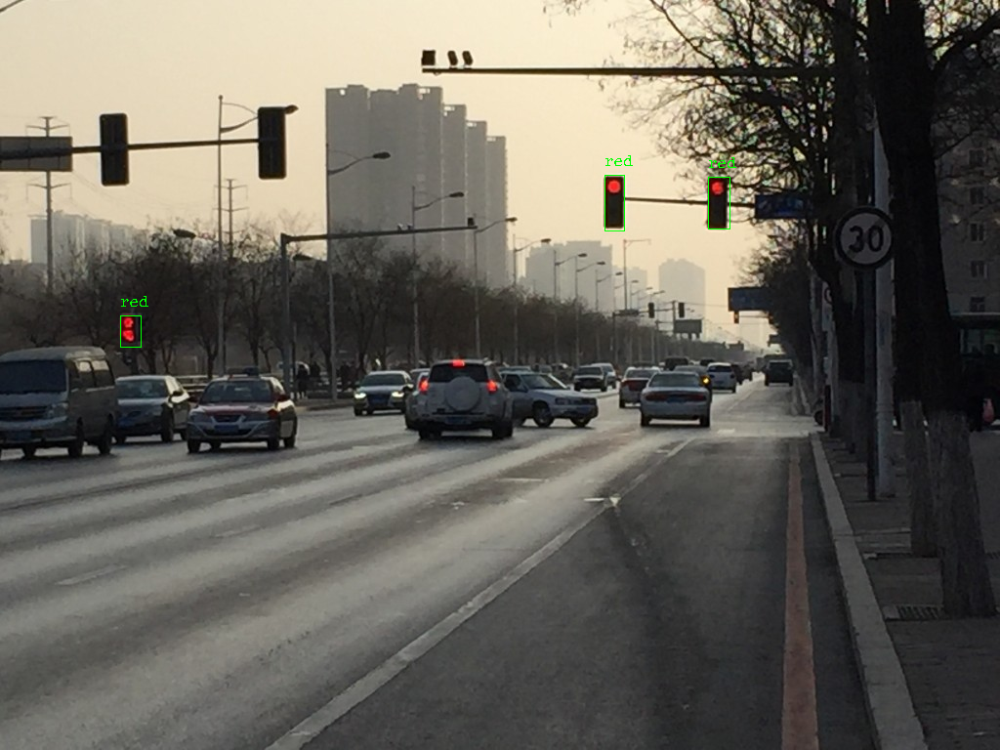

In [41]:
for i in img_and_xml:
    plot_image(i[1],i[0])